# Aula9: Econometria

In [1]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.sandbox.regression.predstd import wls_prediction_std

from numpy import NaN

from sklearn import linear_model

from scipy import stats

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

import math

In [3]:
df = pd.read_stata("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/auto.dta")

## Regressão Linear Robusta

In [4]:
X = df[["weight"]]
y = df["price"]

In [5]:
model = sm.OLS(y, X, missing='drop')
results = model.fit()
print(results.summary())

                                 OLS Regression Results                                
Dep. Variable:                  price   R-squared (uncentered):               30797.616
Model:                            OLS   Adj. R-squared (uncentered):          31219.488
Method:                 Least Squares   F-statistic:                             -73.00
Date:                Mon, 06 Nov 2023   Prob (F-statistic):                        1.00
Time:                        11:40:27   Log-Likelihood:                         -683.04
No. Observations:                  74   AIC:                                      1368.
Df Residuals:                      73   BIC:                                      1370.
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [6]:
model = sm.RLM(y, X, missing='drop', M=sm.robust.norms.HuberT())
results = model.fit()
print(results.summary())

                    Robust linear Model Regression Results                    
Dep. Variable:                  price   No. Observations:                   74
Model:                            RLM   Df Residuals:                       73
Method:                          IRLS   Df Model:                            0
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Mon, 06 Nov 2023                                         
Time:                        11:40:31                                         
No. Iterations:                     6                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
weight         1.9234      0.081     23.714      0.0

## Comparar OLS e RLM

``linspace``: Retorna números uniformemente separeados em um dado intervalo.

In [7]:
nsample = 50
x1 = np.linspace(0, 20, nsample)
X = np.column_stack((x1, (x1-5)**2))
X = sm.add_constant(X)

In [306]:
x1

array([ 0.        ,  0.40816327,  0.81632653,  1.2244898 ,  1.63265306,
        2.04081633,  2.44897959,  2.85714286,  3.26530612,  3.67346939,
        4.08163265,  4.48979592,  4.89795918,  5.30612245,  5.71428571,
        6.12244898,  6.53061224,  6.93877551,  7.34693878,  7.75510204,
        8.16326531,  8.57142857,  8.97959184,  9.3877551 ,  9.79591837,
       10.20408163, 10.6122449 , 11.02040816, 11.42857143, 11.83673469,
       12.24489796, 12.65306122, 13.06122449, 13.46938776, 13.87755102,
       14.28571429, 14.69387755, 15.10204082, 15.51020408, 15.91836735,
       16.32653061, 16.73469388, 17.14285714, 17.55102041, 17.95918367,
       18.36734694, 18.7755102 , 19.18367347, 19.59183673, 20.        ])

In [15]:
X

array([[1.00000000e+00, 0.00000000e+00, 2.50000000e+01],
       [1.00000000e+00, 4.08163265e-01, 2.10849646e+01],
       [1.00000000e+00, 8.16326531e-01, 1.75031237e+01],
       [1.00000000e+00, 1.22448980e+00, 1.42544773e+01],
       [1.00000000e+00, 1.63265306e+00, 1.13390254e+01],
       [1.00000000e+00, 2.04081633e+00, 8.75676801e+00],
       [1.00000000e+00, 2.44897959e+00, 6.50770512e+00],
       [1.00000000e+00, 2.85714286e+00, 4.59183673e+00],
       [1.00000000e+00, 3.26530612e+00, 3.00916285e+00],
       [1.00000000e+00, 3.67346939e+00, 1.75968347e+00],
       [1.00000000e+00, 4.08163265e+00, 8.43398584e-01],
       [1.00000000e+00, 4.48979592e+00, 2.60308205e-01],
       [1.00000000e+00, 4.89795918e+00, 1.04123282e-02],
       [1.00000000e+00, 5.30612245e+00, 9.37109538e-02],
       [1.00000000e+00, 5.71428571e+00, 5.10204082e-01],
       [1.00000000e+00, 6.12244898e+00, 1.25989171e+00],
       [1.00000000e+00, 6.53061224e+00, 2.34277384e+00],
       [1.00000000e+00, 6.93877

In [8]:
sig = 0.3   # Menor variância do erro faz OLS<->RLM contrastarem mais
beta = [5, 0.5, -0.0]
y_true2 = np.dot(X, beta) # multiplicar dois arrays

In [18]:
y_true2

array([ 5.        ,  5.20408163,  5.40816327,  5.6122449 ,  5.81632653,
        6.02040816,  6.2244898 ,  6.42857143,  6.63265306,  6.83673469,
        7.04081633,  7.24489796,  7.44897959,  7.65306122,  7.85714286,
        8.06122449,  8.26530612,  8.46938776,  8.67346939,  8.87755102,
        9.08163265,  9.28571429,  9.48979592,  9.69387755,  9.89795918,
       10.10204082, 10.30612245, 10.51020408, 10.71428571, 10.91836735,
       11.12244898, 11.32653061, 11.53061224, 11.73469388, 11.93877551,
       12.14285714, 12.34693878, 12.55102041, 12.75510204, 12.95918367,
       13.16326531, 13.36734694, 13.57142857, 13.7755102 , 13.97959184,
       14.18367347, 14.3877551 , 14.59183673, 14.79591837, 15.        ])

In [9]:
y2 = y_true2 + sig*1. * np.random.normal(size=nsample)
y2[[39,41,43,45,48]] -= 5   # Adicionar alguns outliers (10% da amostra)

In [20]:
y2

array([ 5.17066102,  5.6250676 ,  5.48416367,  5.15397788,  5.3813611 ,
        5.85703706,  6.13194209,  6.49144525,  6.66341926,  6.62785094,
        7.19005428,  7.125111  ,  7.07023001,  7.63106526,  7.23068873,
        8.31721584,  8.27341082,  8.13433984,  8.74359003,  8.8890936 ,
        9.05613946,  9.58288623,  9.44322966, 10.17212841,  9.41524422,
       10.00356068, 10.77505578, 10.93346017, 10.21285873, 11.18695661,
       10.91845235, 11.12707578, 11.46318876, 11.19881263, 12.29935387,
       11.93032383, 12.32172387, 12.10352041, 12.96659723,  7.57448218,
       13.12512295,  8.24502692, 13.65348792,  8.40927599, 13.73289257,
        8.95764704, 14.71959853, 14.97080798, 10.20141883, 15.00658927])

### Estimar OLS e RLM

In [10]:
res = sm.OLS(y2, X).fit()
print(res.params)

[ 5.14877459  0.51656331 -0.01276139]


In [11]:
resrlm = sm.RLM(y2, X).fit()
print(resrlm.params)

[ 5.10924309e+00  4.97111554e-01 -1.88827404e-03]


### Plot dos Resultados

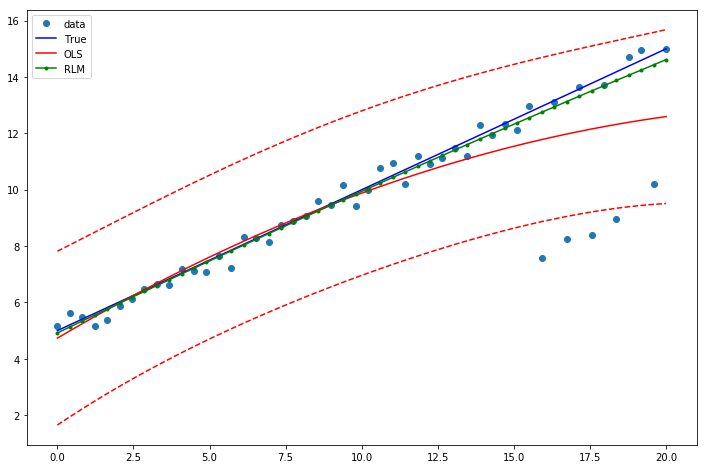

In [28]:
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
ax.plot(x1, y2, 'o',label="data")
ax.plot(x1, y_true2, 'b-', label="True")
prstd, iv_l, iv_u = wls_prediction_std(res) # Obter limites inferior e superior do erro padrão
ax.plot(x1, res.fittedvalues, 'r-', label="OLS")
ax.plot(x1, iv_u, 'r--')
ax.plot(x1, iv_l, 'r--')
ax.plot(x1, resrlm.fittedvalues, 'g.-', label="RLM")
ax.legend(loc="best")
plt.show()

## Logit e Probit

In [307]:
dummie_foreign = pd.get_dummies(df['foreign'],prefix='foreign')
Y = dummie_foreign["foreign_Domestic"]
X = df[["weight", "length"]]
X = sm.add_constant(X)

In [31]:
Y

0     1
1     1
2     1
3     1
4     1
5     1
6     1
7     1
8     1
9     1
10    1
11    1
12    1
13    1
14    1
15    1
16    1
17    1
18    1
19    1
20    1
21    1
22    1
23    1
24    1
25    1
26    1
27    1
28    1
29    1
     ..
44    1
45    1
46    1
47    1
48    1
49    1
50    1
51    1
52    0
53    0
54    0
55    0
56    0
57    0
58    0
59    0
60    0
61    0
62    0
63    0
64    0
65    0
66    0
67    0
68    0
69    0
70    0
71    0
72    0
73    0
Name: foreign_Domestic, Length: 74, dtype: uint8

In [32]:
X.head()

,const,weight,length
0,1.0,2930,186
1,1.0,3350,173
2,1.0,2640,168
3,1.0,3250,196
4,1.0,4080,222


In [33]:
logit_mod = sm.Logit(Y, X)

In [37]:
logit_res = logit_mod.fit()
print(logit_res.summary())

Optimization terminated successfully.
         Current function value: 48.238428
         Iterations 7
                           Logit Regression Results                           
Dep. Variable:       foreign_Domestic   No. Observations:                   74
Model:                          Logit   Df Residuals:                       71
Method:                           MLE   Df Model:                            2
Date:                Mon, 21 Oct 2019   Pseudo R-squ.:                     inf
Time:                        09:35:15   Log-Likelihood:                -3569.6
converged:                       True   LL-Null:                        0.0000
                                        LLR p-value:                     1.000
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -5.3662      5.775     -0.929      0.353     -16.686       5.953
weight         0.0028      0

#### summary2

In [38]:
print(logit_res.summary2())

                         Results: Logit
Model:              Logit            Pseudo R-squared: inf      
Dependent Variable: foreign_Domestic AIC:              7145.2873
Date:               2019-10-21 09:35 BIC:              7152.1995
No. Observations:   74               Log-Likelihood:   -3569.6  
Df Model:           2                LL-Null:          0.0000   
Df Residuals:       71               LLR p-value:      1.0000   
Converged:          1.0000           Scale:            1.0000   
No. Iterations:     7.0000                                      
------------------------------------------------------------------
          Coef.    Std.Err.      z      P>|z|     [0.025    0.975]
------------------------------------------------------------------
const    -5.3662     5.7753   -0.9292   0.3528   -16.6857   5.9532
weight    0.0028     0.0017    1.6953   0.0900    -0.0004   0.0061
length   -0.0089     0.0543   -0.1643   0.8695    -0.1153   0.0975



In [39]:
probit_mod = sm.Probit(Y, X)
probit_res = probit_mod.fit()
print(probit_res.summary2())

         Current function value: 0.000000
         Iterations: 35
                          Results: Probit
Model:                Probit           Pseudo R-squared: inf        
Dependent Variable:   foreign_Domestic AIC:              6.0000     
Date:                 2019-10-21 09:36 BIC:              12.9122    
No. Observations:     74               Log-Likelihood:   -2.7587e-12
Df Model:             2                LL-Null:          0.0000     
Df Residuals:         71               LLR p-value:      1.0000     
Converged:            0.0000           Scale:            1.0000     
No. Iterations:       35.0000                                       
--------------------------------------------------------------------
        Coef.    Std.Err.     z    P>|z|      [0.025       0.975]   
--------------------------------------------------------------------
const   5.8513 944136.3093  0.0000 1.0000 -1850467.3114 1850479.0140
weight -0.0011    499.7307 -0.0000 1.0000     -979.4552     979.

### Em Logit e Probit, não estamos interessados nos coeficientes da regressão em si. Mas nos efeitos marginais

In [40]:
print(probit_res.get_margeff(at='overall', method='dydx').summary())

       Probit Marginal Effects       
Dep. Variable:       foreign_Domestic
Method:                          dydx
At:                           overall
                dy/dx    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
weight     -2.884e-16   2.17e-10  -1.33e-06      1.000   -4.24e-10    4.24e-10
length      7.634e-15   5.73e-09   1.33e-06      1.000   -1.12e-08    1.12e-08


# Regressão Quantílica

Gerar dados com variância constante

loc : Mean (“centre”) of the distribution.

scale : Standard deviation (spread or “width”) of the distribution.

In [12]:
x = np.arange(100).reshape(100,1) 
intercept_ = 6 
slope_ = 0.1 
## erro não constante 
error_ = np.random.normal(size = (100,1), loc = 0.0, scale = 1) 
## Equação da Regressão 
y = intercept_ + slope_ * x + error_

In [42]:
x[0:5]

array([[0],
       [1],
       [2],
       [3],
       [4]])

In [43]:
error_[0:5]

array([[-0.86350673],
       [ 0.08449292],
       [ 0.84347986],
       [ 2.96090526],
       [ 0.84544251]])

In [44]:
y[0:5]

array([[5.13649327],
       [6.18449292],
       [7.04347986],
       [9.26090526],
       [7.24544251]])

### Plot dos Dados

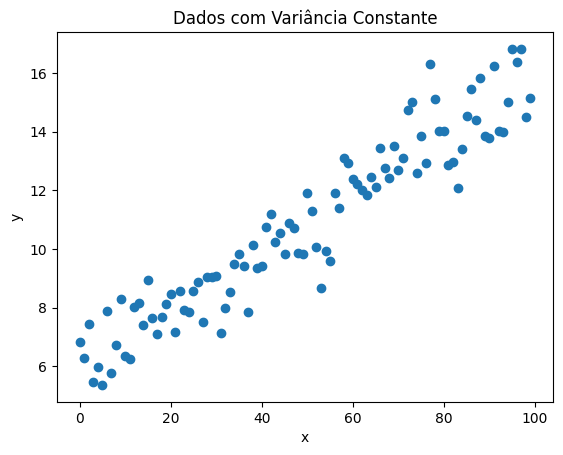

In [13]:
plt.figure(1) 
plt.scatter(x, y) 
plt.xlabel("x") 
plt.ylabel("y") 
plt.title("Dados com Variância Constante")
plt.show()

Vamos rodar uma OLS nos dados acima

In [14]:
model1 = linear_model.LinearRegression(fit_intercept = True) 
model1.fit(x, y)

LinearRegression()

### Obter valores preditos

In [15]:
y_pred1 = model1.predict(x)

In [16]:
y_pred1[0:5]

array([[5.95396983],
       [6.05301186],
       [6.15205389],
       [6.25109593],
       [6.35013796]])

In [17]:
ols = model1.coef_

### Observe o valor bem próximo de 0.1

In [18]:
ols

array([[0.09904203]])

In [19]:
print("Mean squared error: {0:.2f}".format(np.mean((y_pred1 - y) ** 2))) 
print('Variance score: {0:.2f}'.format(model1.score(x, y)))

Mean squared error: 0.89
Variance score: 0.90


#### Vamos plotar a regressão

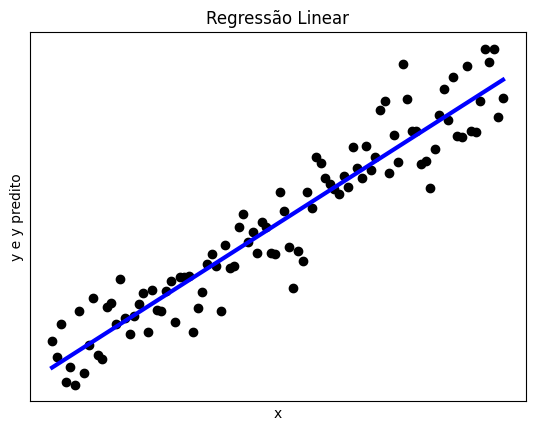

In [20]:
plt.figure(2) 
plt.scatter(x, y, color='black') 
plt.plot(x, y_pred1, color='blue', linewidth=3)  
plt.xticks(()) 
plt.yticks(()) 
plt.xlabel("x") 
plt.ylabel("y e y predito") 
plt.title("Regressão Linear")
plt.show()

#### Vamos agora gerar dados com variância não constante

In [21]:
x_ = np.arange(100).reshape(100,1) 
intercept_ = 6 
slope_ = 0.1 
## Variância não constante 
var_ = 0.1 + 0.05 * x_ 
## erro não constante 
error_ = np.random.normal(size = (100,1), loc = 0.0, scale = var_) 

In [22]:
x_[0:5]

array([[0],
       [1],
       [2],
       [3],
       [4]])

In [23]:
var_[0:5]

array([[0.1 ],
       [0.15],
       [0.2 ],
       [0.25],
       [0.3 ]])

In [24]:
error_[0:5]

array([[ 0.09667549],
       [-0.34830098],
       [-0.2019896 ],
       [-0.32241877],
       [ 0.36689053]])

## Equação da Regressão 

In [25]:
y_ = intercept_ + slope_ * x + error_ 

### Plot dos Dados

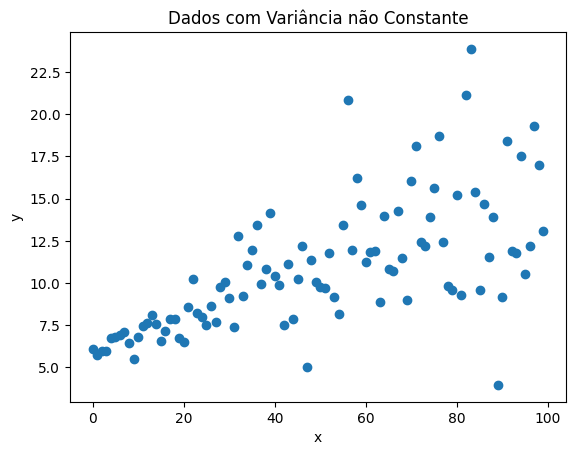

In [26]:
plt.figure(3) 
plt.scatter(x_, y_) 
plt.xlabel("x") 
plt.ylabel("y") 
plt.title("Dados com Variância não Constante")
plt.show()

Vamos tentar ajustar uma regressão linear

In [27]:
model2 = linear_model.LinearRegression(fit_intercept = True) 
model2.fit(x_, y_)

LinearRegression()

In [28]:
y_pred2 = model2.predict(x_)

In [29]:
y_pred2[0:5]

array([[6.50477867],
       [6.59280851],
       [6.68083834],
       [6.76886817],
       [6.856898  ]])

In [30]:
ols2 = model2.coef_

In [31]:
print(ols2)

[[0.08802983]]


In [32]:
print("Mean squared error: {0:.2f}".format(np.mean((y_pred2 - y_) ** 2))) 
print('Variance score: {0:.2f}'.format(model1.score(x_, y_)))

Mean squared error: 8.46
Variance score: 0.43


#### Vamos plotar a regressão

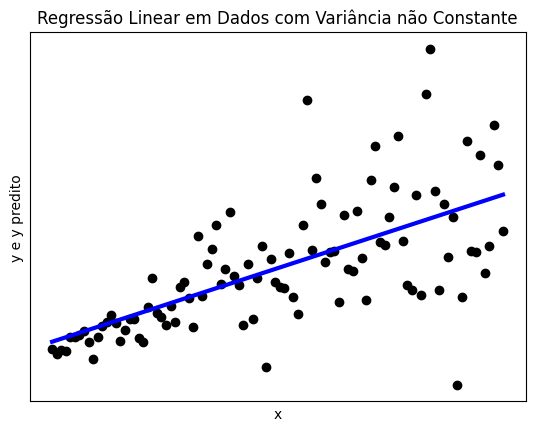

In [33]:
plt.figure(4) 
plt.scatter(x_, y_, color='black') 
plt.plot(x_, y_pred2, color='blue', linewidth=3)  
plt.xticks(()) 
plt.yticks(()) 
plt.xlabel("x") 
plt.ylabel("y e y predito") 
plt.title("Regressão Linear em Dados com Variância não Constante")
plt.show()

#### Vamos, agora, rodar uma Regressão Quantílica para a mediana dos dados (Quantil 0.5)

In [34]:
data = pd.DataFrame(data = np.hstack([x_, y_]), columns = ["x", "y"])

In [35]:
data.head()

,x,y
0,0.0,6.096675
1,1.0,5.751699
2,2.0,5.998010
3,3.0,5.977581
4,4.0,6.766891


#### Regressão Quantílica

In [36]:
mod = smf.quantreg('y ~ x', data)

In [37]:
mod

In [38]:
res = mod.fit(q=.5) 
print(res.summary())

                         QuantReg Regression Results                          
Dep. Variable:                      y   Pseudo R-squared:               0.3351
Model:                       QuantReg   Bandwidth:                       2.018
Method:                 Least Squares   Sparsity:                        5.473
Date:                Mon, 06 Nov 2023   No. Observations:                  100
Time:                        11:44:50   Df Residuals:                       98
                                        Df Model:                            1
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      6.3846      0.543     11.753      0.000       5.307       7.463
x              0.0862      0.009      9.088      0.000       0.067       0.105


#### Observe que estimamos o modelo para o quantil 0.5 e que o coeficiente do modelo se aproxima bastante do OLS

#### Construir o modelo para outros quantis

In [39]:
quantiles = np.arange(0.1,1,0.01) 
print(quantiles) 

[0.1  0.11 0.12 0.13 0.14 0.15 0.16 0.17 0.18 0.19 0.2  0.21 0.22 0.23
 0.24 0.25 0.26 0.27 0.28 0.29 0.3  0.31 0.32 0.33 0.34 0.35 0.36 0.37
 0.38 0.39 0.4  0.41 0.42 0.43 0.44 0.45 0.46 0.47 0.48 0.49 0.5  0.51
 0.52 0.53 0.54 0.55 0.56 0.57 0.58 0.59 0.6  0.61 0.62 0.63 0.64 0.65
 0.66 0.67 0.68 0.69 0.7  0.71 0.72 0.73 0.74 0.75 0.76 0.77 0.78 0.79
 0.8  0.81 0.82 0.83 0.84 0.85 0.86 0.87 0.88 0.89 0.9  0.91 0.92 0.93
 0.94 0.95 0.96 0.97 0.98 0.99]


In [41]:
models = [] 
params = []  
for qt in quantiles:  
    print(qt)  
    res = mod.fit(q = qt )
    models.append(res)
    params.append([qt, res.params['Intercept'], res.params['x']] + [res.conf_int()[0]['x'],res.conf_int()[1]['x']])

0.1
0.11
0.12
0.13
0.13999999999999999
0.14999999999999997
0.15999999999999998
0.16999999999999998
0.17999999999999997
0.18999999999999995
0.19999999999999996
0.20999999999999996
0.21999999999999995
0.22999999999999995
0.23999999999999994
0.24999999999999992
0.2599999999999999
0.2699999999999999
0.2799999999999999
0.2899999999999999
0.29999999999999993
0.30999999999999994
0.3199999999999999
0.32999999999999985
0.33999999999999986
0.34999999999999987
0.3599999999999999
0.3699999999999999
0.3799999999999999
0.3899999999999999
0.3999999999999998
0.4099999999999998
0.4199999999999998
0.4299999999999998
0.43999999999999984
0.44999999999999984
0.45999999999999985
0.46999999999999986
0.47999999999999976
0.48999999999999977
0.4999999999999998
0.5099999999999998
0.5199999999999998
0.5299999999999998
0.5399999999999998
0.5499999999999998
0.5599999999999997
0.5699999999999997
0.5799999999999997
0.5899999999999997
0.5999999999999998
0.6099999999999998
0.6199999999999998
0.6299999999999997
0.639999

In [42]:
models

In [43]:
res.conf_int()

,0,1
Intercept,NaN,NaN
x,NaN,NaN


In [44]:
params

[[0.1,
  5.846503596153661,
  0.04369261044583005,
  0.02244406672882735,
  0.06494115416283275],
 [0.11,
  5.840434146328965,
  0.04571615291465055,
  0.025220977662370265,
  0.06621132816693084],
 [0.12,
  5.8384755568521465,
  0.04637035249886087,
  0.0262961215564398,
  0.06644458344128194],
 [0.13,
  5.834862299340496,
  0.047574216180011834,
  0.02806424133245762,
  0.06708419102756605],
 [0.13999999999999999,
  5.835284056304575,
  0.04756888767748969,
  0.027024634104282755,
  0.06811314125069662],
 [0.14999999999999997,
  5.833004251588624,
  0.04819204889111731,
  0.02854299832016219,
  0.06784109946207244],
 [0.15999999999999998,
  5.832996702732022,
  0.04819487727739863,
  0.027268191651801225,
  0.06912156290299604],
 [0.16999999999999998,
  5.826924189856858,
  0.049764542970668624,
  0.03045921801166596,
  0.06906986792967129],
 [0.17999999999999997,
  5.828332530526601,
  0.04974973866576413,
  0.02835278189799818,
  0.07114669543353008],
 [0.18999999999999995,
  5.896

#### Colocar os parâmetros em um DataFrame

In [45]:
params = pd.DataFrame(data = params, columns = ['qt','intercept','x_coef','cf_lower_bound','cf_upper_bound'])  
print(params)

      qt  intercept    x_coef  cf_lower_bound  cf_upper_bound
0   0.10   5.846504  0.043693        0.022444        0.064941
1   0.11   5.840434  0.045716        0.025221        0.066211
2   0.12   5.838476  0.046370        0.026296        0.066445
3   0.13   5.834862  0.047574        0.028064        0.067084
4   0.14   5.835284  0.047569        0.027025        0.068113
..   ...        ...       ...             ...             ...
85  0.95   7.396255  0.167945        0.150702        0.185189
86  0.96   6.096675  0.207028        0.179393        0.234663
87  0.97   6.096674  0.209480             NaN             NaN
88  0.98   6.096675  0.214173             NaN             NaN
89  0.99   6.096675  0.263599             NaN             NaN

[90 rows x 5 columns]


#### Plot dos dados e de cada regressão

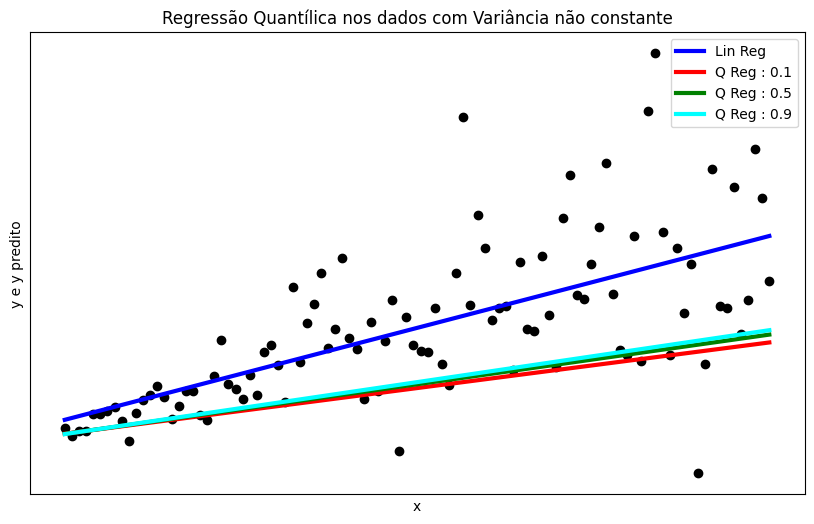

In [46]:
plt.figure(5,figsize=(10,6)) 
plt.scatter(x_, y_,  color='black') 
plt.plot(x_, y_pred2, color='blue', linewidth=3, label='Lin Reg')  
y_pred3 = models[0].params['Intercept'] + models[0].params['x'] * x_ 
plt.plot(x_, y_pred3, color='red', linewidth=3, label='Q Reg : 0.1')  
y_pred4 = models[4].params['Intercept'] + models[4].params['x'] * x_ 
plt.plot(x_, y_pred4, color='green', linewidth=3, label='Q Reg : 0.5')   
y_pred5 = models[8].params['Intercept'] + models[8].params['x'] * x_ 
plt.plot(x_, y_pred5, color='cyan', linewidth=3, label='Q Reg : 0.9')   
plt.xticks(()) 
plt.yticks(()) 
plt.xlabel("x") 
plt.ylabel("y e y predito") 
plt.title("Regressão Quantílica nos dados com Variância não constante") 
plt.legend()
plt.show()

#### Plotar mudanças nos coeficientes dos quantís

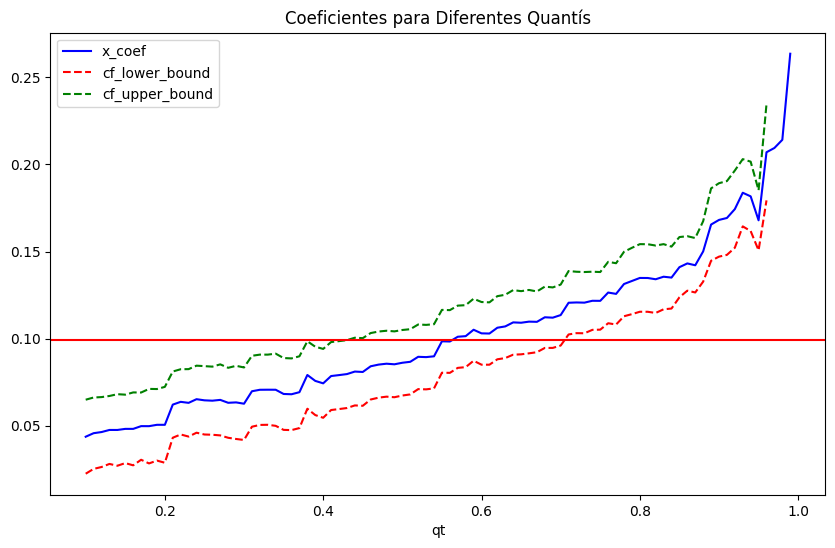

In [47]:
params.plot(x = 'qt', y = ['x_coef','cf_lower_bound','cf_upper_bound'], title = 'Coeficientes para Diferentes Quantís', kind ='line', style = ['b-','r--','g--'], figsize=(10,6))
plt.axhline(y=ols, color='r', linestyle='-')
plt.show()

# Modelo Poisson (Bombas $2^o$ Guerra em Londres)

In [48]:
x = [229,211,93,35,7,1]
x = sm.add_constant(x)
y = [0,1,2,3,4,5]

In [49]:
x

array([[  1., 229.],
       [  1., 211.],
       [  1.,  93.],
       [  1.,  35.],
       [  1.,   7.],
       [  1.,   1.]])

In [51]:
model2 = sm.Poisson(y, x).fit()
print(model2.summary2())

Optimization terminated successfully.
         Current function value: 1.305312
         Iterations 6
                        Results: Poisson
Model:              Poisson          Method:           MLE      
Dependent Variable: y                Pseudo R-squared: 0.331    
Date:               2023-11-06 11:48 AIC:              19.6637  
No. Observations:   6                BIC:              19.2473  
Df Model:           1                Log-Likelihood:   -7.8319  
Df Residuals:       4                LL-Null:          -11.706  
Converged:          1.0000           LLR p-value:      0.0053759
No. Iterations:     6.0000           Scale:            1.0000   
------------------------------------------------------------------
          Coef.    Std.Err.      z      P>|z|     [0.025    0.975]
------------------------------------------------------------------
const     1.5377     0.3047    5.0470   0.0000    0.9406    2.1349
x1       -0.0102     0.0045   -2.2452   0.0248   -0.0191   -0.0013



In [52]:
lamb = np.exp(-0.0102)
lamb

0.9898518435820949

In [53]:
tot = 537

In [54]:
def poisson(x):
    poi = ((np.exp(-lamb))*(lamb**x))/math.factorial(x)
    prev = poi*tot
    return prev

In [55]:
x

array([[  1., 229.],
       [  1., 211.],
       [  1.,  93.],
       [  1.,  35.],
       [  1.,   7.],
       [  1.,   1.]])

In [56]:
print(poisson(0),poisson(1),poisson(2),poisson(3),poisson(4),poisson(5))

199.56624790909976 197.54101840958378 97.76817062790553 32.258667979893694 7.982825492850119 1.580362906218367


In [57]:
poisson(15)

1.3096053038272855e-10

# Imagens e Captchas

In [3]:
!pip install scikit-image

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.5/12.5 MB 21.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.3/210.3 kB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 25.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 22.0 MB/s eta 0:00:00a 0:00:01


In [59]:
import skimage.io

In [60]:
from PIL import Image
import math
import sys

In [62]:
im1 = Image.open("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele.jpg")

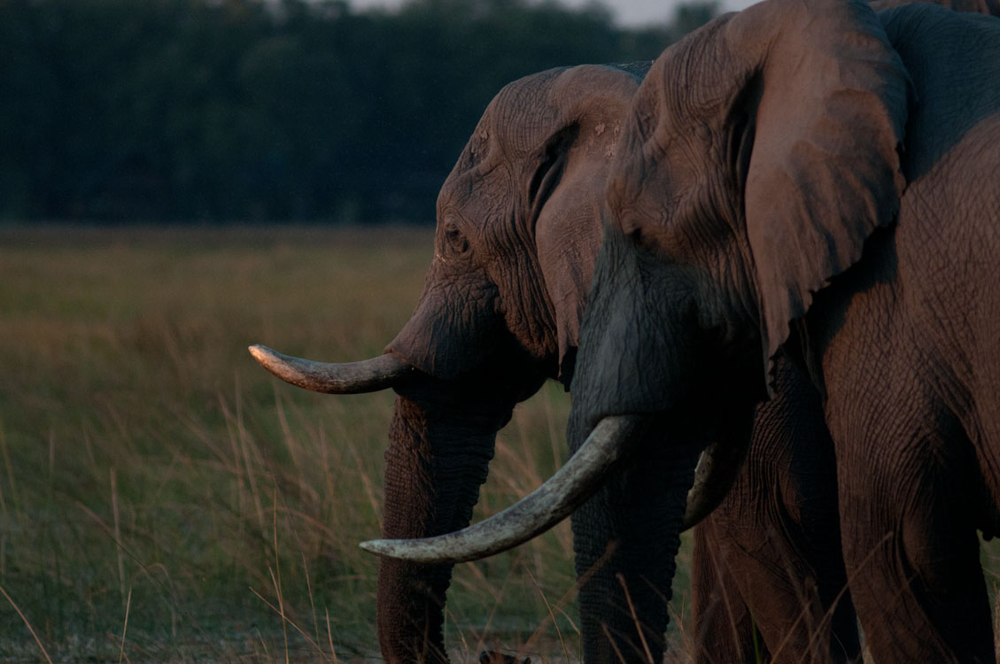

In [63]:
im1

In [64]:
im1.size

(1129, 750)

In [65]:
width, height = im1.size

In [66]:
width

1129

In [67]:
height

750

In [68]:
width, height

(1129, 750)

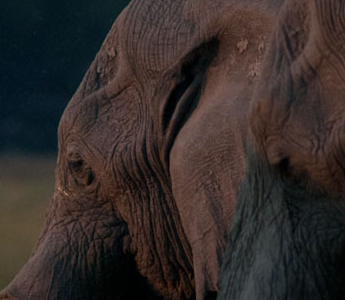

In [69]:
cropped_image1 = im1.crop((435,100, 780, 400))
cropped_image1

In [70]:
int(width*5)

5645

In [71]:
int(height*5)

3750

In [72]:
im2 = im1.resize((int(width*5), int(height*5)), Image.BICUBIC)

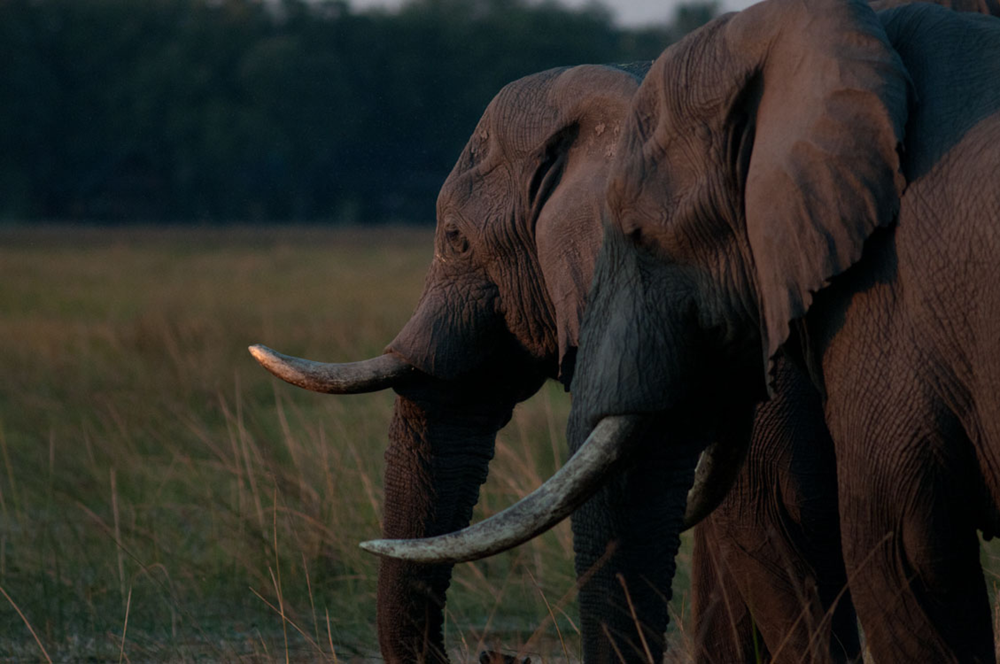

In [73]:
im2

In [74]:
im2.size

(5645, 3750)

In [75]:
im2.save("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele_grande.jpg")

In [76]:
width, height = im2.size

In [77]:
width, height

(5645, 3750)

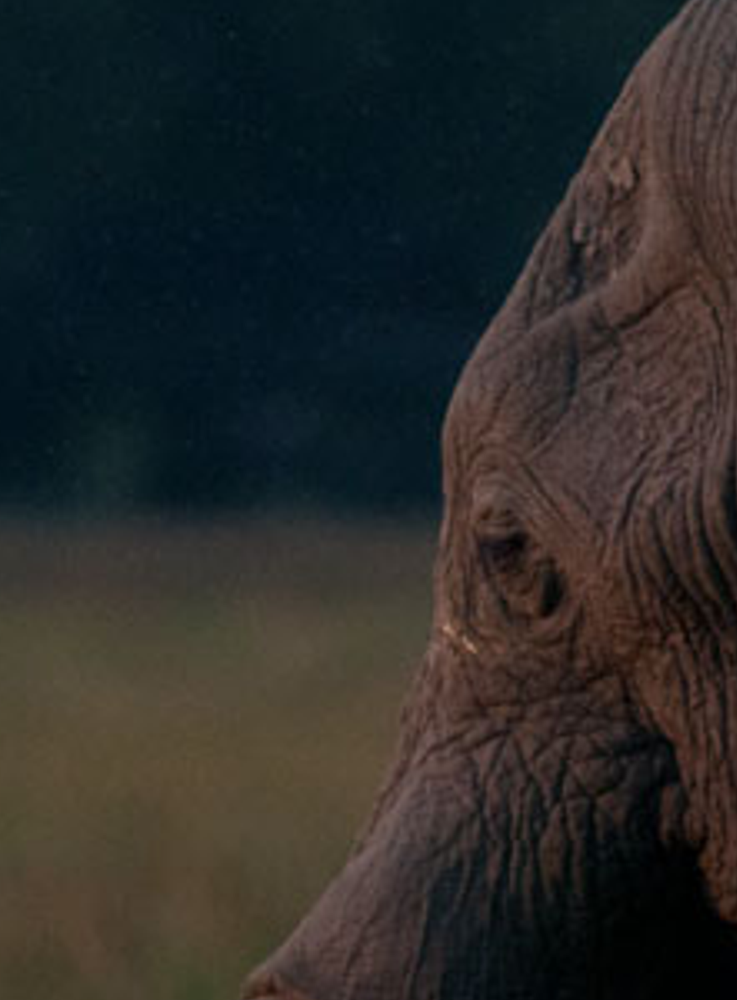

In [78]:
cropped_image2 = im2.crop((1800, 500, 2906, 2000))
cropped_image2

In [79]:
import glob

In [80]:
glob.glob('/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/*.jpg')

['/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/z.jpg',
 '/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele.jpg',
 '/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele_grande.jpg']

In [81]:
files = glob.glob('/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/*.jpg')

In [82]:
files

['/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/z.jpg',
 '/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele.jpg',
 '/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele_grande.jpg']

In [83]:
from glob import glob

In [86]:
files = glob('/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/*.jpg')

In [87]:
files

['/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/z.jpg',
 '/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele.jpg',
 '/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele_grande.jpg']

In [88]:
for file in files:
    print(file)

/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/z.jpg
/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele.jpg
/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele_grande.jpg


In [89]:
for file in files:
    isabelita = Image.open(file)
    isabelita

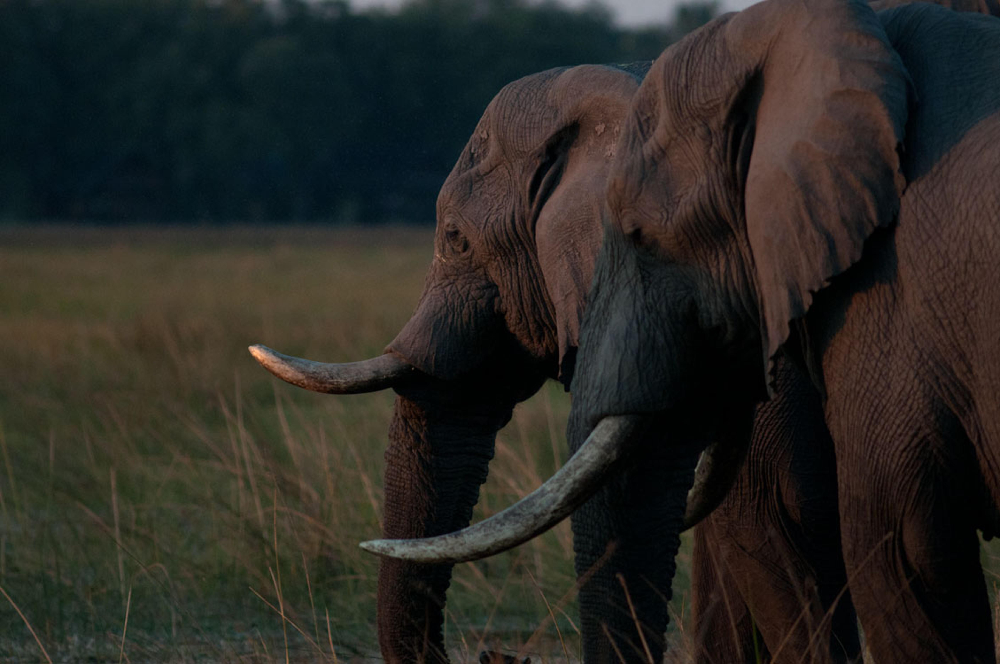

In [90]:
isabelita

In [91]:
im2.save("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele1.jpg")

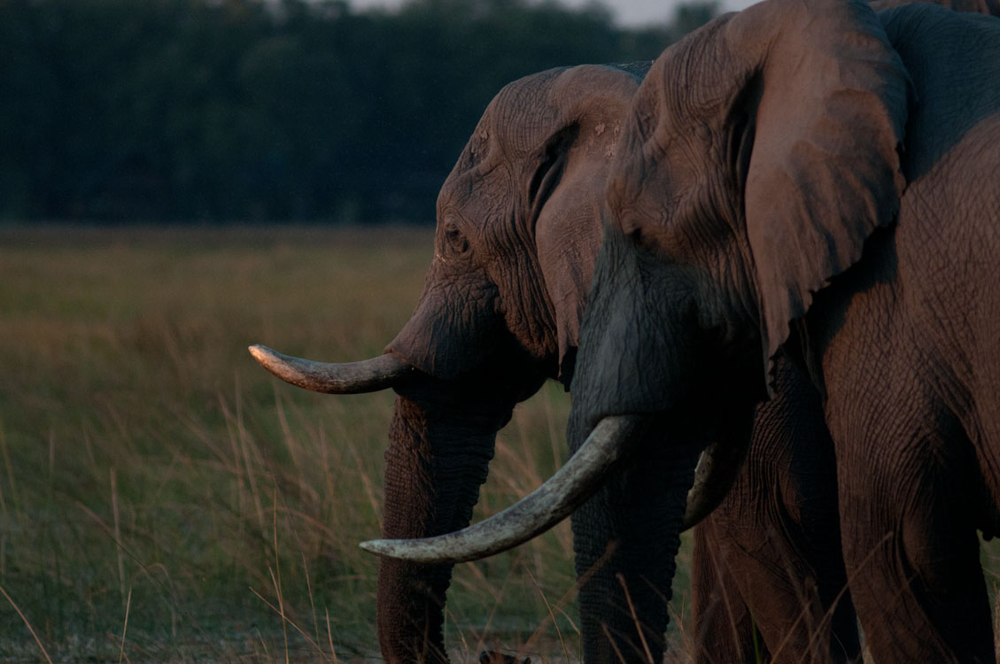

In [92]:
im1

In [93]:
image_data = skimage.io.imread("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele.jpg")

In [94]:
image_data

array([[[25, 34, 33],
        [26, 34, 36],
        [27, 35, 37],
        ...,
        [45, 37, 34],
        [53, 44, 39],
        [69, 44, 40]],

       [[26, 35, 34],
        [26, 34, 36],
        [26, 34, 36],
        ...,
        [41, 36, 32],
        [48, 40, 37],
        [65, 42, 36]],

       [[26, 36, 35],
        [25, 35, 36],
        [24, 34, 35],
        ...,
        [36, 32, 29],
        [40, 35, 32],
        [58, 39, 32]],

       ...,

       [[54, 58, 44],
        [47, 53, 39],
        [43, 51, 36],
        ...,
        [74, 58, 43],
        [69, 52, 34],
        [59, 45, 32]],

       [[53, 57, 43],
        [46, 52, 38],
        [42, 50, 35],
        ...,
        [71, 55, 40],
        [66, 49, 31],
        [61, 47, 34]],

       [[44, 47, 38],
        [44, 50, 40],
        [45, 53, 42],
        ...,
        [71, 55, 40],
        [70, 53, 35],
        [53, 39, 26]]], dtype=uint8)

In [95]:
len(image_data)

750

In [96]:
len(image_data[0])

1129

In [97]:
image_data[0][0]

array([25, 34, 33], dtype=uint8)

In [98]:
image_data[0]

array([[25, 34, 33],
       [26, 34, 36],
       [27, 35, 37],
       ...,
       [45, 37, 34],
       [53, 44, 39],
       [69, 44, 40]], dtype=uint8)

In [99]:
for i in image_data[0]:
    i[0] = i[0]+100
    i[1] = i[1]+100
    i[2] = i[2]+100

In [100]:
image_data[0]

array([[125, 134, 133],
       [126, 134, 136],
       [127, 135, 137],
       ...,
       [145, 137, 134],
       [153, 144, 139],
       [169, 144, 140]], dtype=uint8)

In [101]:
skimage.io.imsave("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele_filtro.jpg", image_data)

In [102]:
ingrid = Image.open("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele_filtro.jpg")

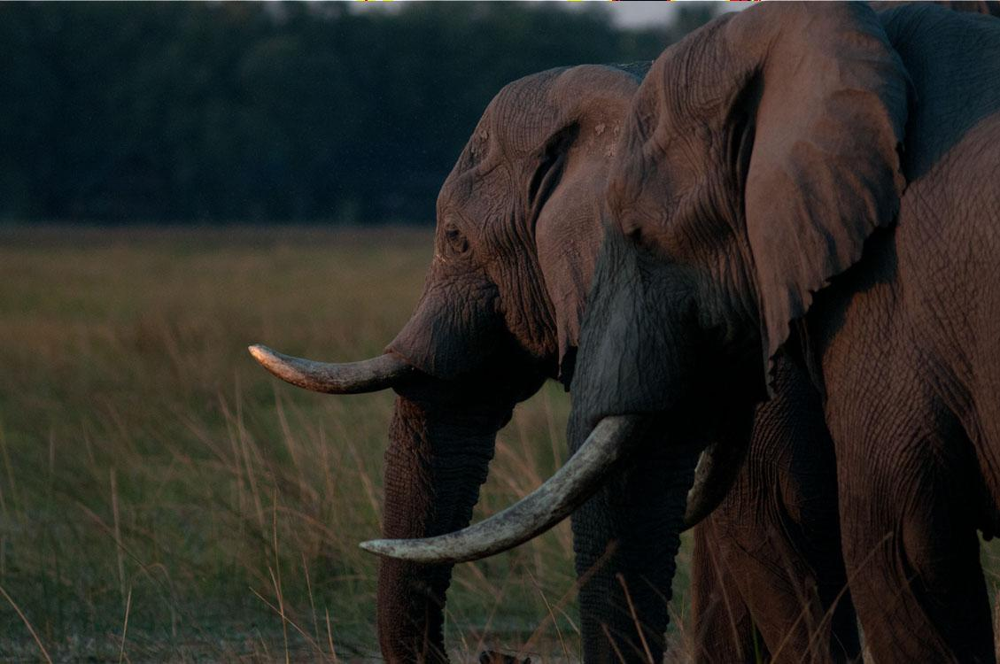

In [103]:
ingrid

In [ ]:
array[[[[25, 34, 33],[25, 34, 42]],[],[]]]

In [104]:
image_data[0][0]

array([125, 134, 133], dtype=uint8)

In [105]:
for row_data in image_data:
    for pixel in row_data:
        print(pixel)

[125 134 133]
[126 134 136]
[127 135 137]
[128 136 138]
[129 137 140]
[129 137 140]
[128 135 141]
[128 135 141]
[127 136 141]
[125 134 139]
[124 133 138]
[123 134 138]
[123 134 138]
[123 134 138]
[120 134 137]
[118 132 135]
[116 131 134]
[118 133 136]
[119 134 137]
[118 133 136]
[117 132 135]
[115 130 133]
[116 131 134]
[117 132 135]
[116 131 138]
[116 131 136]
[116 131 136]
[116 131 136]
[117 132 135]
[118 133 136]
[119 135 135]
[120 136 136]
[123 137 140]
[124 138 141]
[126 140 143]
[127 141 144]
[129 143 146]
[130 144 147]
[130 144 147]
[130 144 147]
[135 146 150]
[136 147 151]
[136 147 151]
[136 147 151]
[135 146 150]
[134 145 149]
[133 144 148]
[132 143 147]
[130 145 148]
[128 143 146]
[126 141 144]
[125 140 143]
[126 141 144]
[126 141 144]
[124 139 142]
[123 138 141]
[123 139 138]
[123 139 138]
[124 140 139]
[124 140 139]
[123 139 138]
[122 138 137]
[120 136 135]
[119 135 134]
[122 138 138]
[121 137 137]
[121 137 137]
[120 136 136]
[121 137 137]
[122 138 138]
[123 139 139]
[123 1

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




[38 40 37]
[31 33 30]
[23 25 22]
[22 24 21]
[28 30 27]
[38 36 37]
[33 31 32]
[23 21 22]
[19 17 18]
[17 15 16]
[13 11 12]
[19 17 18]
[35 33 34]
[44 41 36]
[45 42 37]
[41 37 34]
[29 25 22]
[19 15 12]
[16 12 11]
[16 12 11]
[17 13 12]
[29 26 21]
[38 35 30]
[35 32 27]
[34 29 25]
[41 36 32]
[36 28 25]
[26 18 15]
[30 22 19]
[22 22 20]
[19 19 17]
[17 17 15]
[13 13 11]
[7 7 5]
[4 4 2]
[10 10  8]
[18 18 16]
[31 28 21]
[31 28 23]
[20 19 17]
[16 15 13]
[15 11 10]
[31 21 19]
[61 46 41]
[68 49 43]
[49 30 24]
[52 31 26]
[54 33 28]
[55 32 26]
[70 45 40]
[88 61 54]
[90 61 55]
[94 65 59]
[92 67 60]
[90 65 58]
[87 62 55]
[86 61 54]
[86 61 54]
[84 59 52]
[82 57 50]
[80 55 48]
[84 61 55]
[83 60 54]
[81 58 52]
[79 56 50]
[76 53 47]
[76 53 47]
[78 55 49]
[80 57 51]
[84 61 53]
[87 64 56]
[89 66 58]
[90 67 59]
[88 65 57]
[85 62 54]
[82 59 51]
[81 58 50]
[69 50 46]
[57 42 39]
[40 31 32]
[26 24 27]
[23 22 27]
[25 26 28]
[28 30 29]
[29 29 27]
[33 29 28]
[34 28 28]
[40 34 34]
[42 34 32]
[47 37 36]
[44 33 31]
[35 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[4 8 7]
[1 5 4]
[1 3 2]
[1 3 2]
[0 2 1]
[0 2 1]
[1 3 2]
[1 3 2]
[2 4 3]
[3 5 4]
[5 7 6]
[6 8 7]
[7 9 8]
[7 9 8]
[7 9 8]
[ 8 10  9]
[10 12 11]
[12 14 13]
[13 13 13]
[15 15 15]
[16 16 16]
[14 14 14]
[11 11 11]
[8 8 8]
[6 6 6]
[6 6 6]
[3 3 3]
[1 1 1]
[6 6 6]
[5 7 6]
[ 8 10  9]
[ 8 12 11]
[ 8 12 11]
[23 27 26]
[43 52 33]
[48 57 38]
[50 59 40]
[47 56 37]
[45 54 35]
[48 57 38]
[51 60 41]
[52 61 42]
[52 61 44]
[52 61 44]
[50 59 42]
[48 57 40]
[49 58 41]
[52 61 44]
[52 61 44]
[50 59 42]
[49 56 40]
[50 57 41]
[51 58 42]
[51 58 42]
[51 58 42]
[51 58 42]
[52 59 43]
[54 61 45]
[56 63 47]
[57 64 48]
[57 64 48]
[56 63 47]
[56 63 47]
[55 62 46]
[54 61 45]
[54 61 45]
[52 59 41]
[53 60 42]
[54 61 43]
[53 60 42]
[52 59 41]
[52 59 41]
[53 60 42]
[54 61 43]
[58 59 43]
[61 62 46]
[64 65 49]
[63 66 49]
[61 64 47]
[57 61 44]
[54 58 41]
[53 57 40]
[55 59 42]
[52 56 39]
[50 54 37]
[54 57 40]
[57 60 43]
[60 61 45]
[63 64 48]
[68 69 53]
[71 63 50]
[67 57 45]
[73 61 49]
[79 67 55]
[75 65 53]
[70 64 50]
[64 65 49]

In [106]:
pixel[:]

array([53, 39, 26], dtype=uint8)

In [107]:
np.rint(255 * (pixel / 255)**0.7)

array([85., 69., 52.])

In [108]:
np.rint(255 * (pixel / 255) ** 0.7)

array([85., 69., 52.])

In [109]:
for row_data in image_data:
    for pixel in row_data:
        pixel[:] = np.rint(255 * (pixel / 255) ** 0.7) # rint: arredonda itens para o inteiro mais próximo

In [110]:
image_data

array([[[155, 163, 162],
        [156, 163, 164],
        [157, 163, 165],
        ...,
        [172, 165, 163],
        [178, 171, 167],
        [191, 171, 168]],

       [[ 52,  64,  62],
        [ 52,  62,  65],
        [ 52,  62,  65],
        ...,
        [ 71,  65,  60],
        [ 79,  70,  66],
        [ 98,  72,  65]],

       [[ 52,  65,  64],
        [ 50,  64,  65],
        [ 49,  62,  64],
        ...,
        [ 65,  60,  56],
        [ 70,  64,  60],
        [ 90,  69,  60]],

       ...,

       [[ 86,  90,  75],
        [ 78,  85,  69],
        [ 73,  83,  65],
        ...,
        [107,  90,  73],
        [102,  84,  62],
        [ 92,  76,  60]],

       [[ 85,  89,  73],
        [ 77,  84,  67],
        [ 72,  82,  64],
        ...,
        [104,  87,  70],
        [ 99,  80,  58],
        [ 94,  78,  62]],

       [[ 75,  78,  67],
        [ 75,  82,  70],
        [ 76,  85,  72],
        ...,
        [104,  87,  70],
        [103,  85,  64],
        [ 85,  69,  52]]

In [111]:
skimage.io.imsave("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele_H.jpg", image_data)

In [113]:
im3 = Image.open("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele_H.jpg")

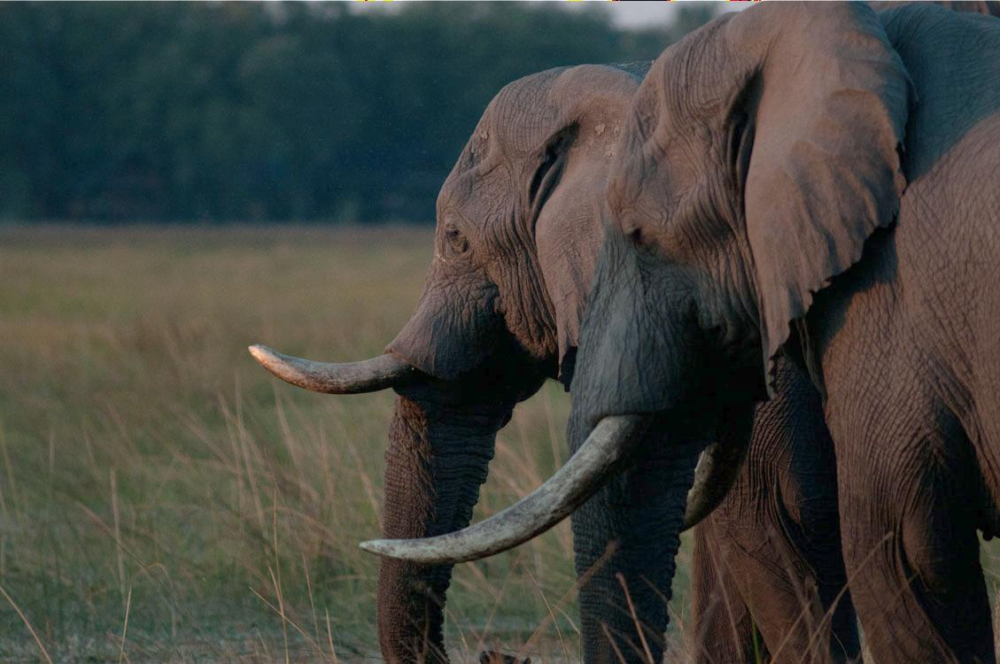

In [114]:
im3

In [115]:
def square_root_filter(input_image_file_name, output_image_file_name):
    image_data = skimage.io.imread(input_image_file_name)
    for row_data in image_data:
        for pixel in row_data:
            pixel[:] = np.rint(255 * (pixel / 255) ** 0.8)
    skimage.io.imsave(output_image_file_name, image_data)
    #im = Image.open(output_image_file_name)
    #im.show()

In [116]:
square_root_filter("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/ele.jpg","/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/filtro_ele.jpg")

In [117]:
def example(arg1, arg2=200 ):
    a = arg1/arg2
    return a

In [118]:
example(568)

2.84

# Resolver Captcha

In [121]:
def decoder(im, threshold=200, mask="/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/letters.bmp", alphabet="0123456789abcdef"): 
    img = Image.open(im)
    img = img.convert("RGB")
    box = (8, 8, 58, 18) # Crop from x, y, w, h -> 100, 200, 300, 400
    img = img.crop(box)
    pixdata = img.load()
    # open the mask
    letters = Image.open(mask)
    letters = letters.convert("RGB")
    ledata = letters.load()
    
    def test_letter(img, letter):
        A = img.load()
        B = letter.load()
        mx = 1000000
        max_x = 0
        x = 0
        for x in range(img.size[0] - letter.size[0]):
            _sum = 0
            for i in range(letter.size[0]):
                for j in range(letter.size[1]):
                    _sum = _sum + abs(A[x + i, j][0] - B[i, j][0])
            if _sum < mx:
                mx = _sum
                max_x = x
        return mx, max_x
    
    # Clean the background noise, if color != white, then set to black.
    for y in range(img.size[1]):
        for x in range(img.size[0]):
            if (pixdata[x, y][0] > threshold) \
                    and (pixdata[x, y][1] > threshold) \
                    and (pixdata[x, y][2] > threshold):
                pixdata[x, y] = (255, 255, 255, 255)
            else:
                pixdata[x, y] = (0, 0, 0, 255)
    
    counter = 0
    old_x = -1
    letterlist = []
    
    for x in range(letters.size[0]):
        black = True
        for y in range(letters.size[1]):
            if ledata[x, y][0] != 0:
                black = False
                break
        if black:
            box = (old_x + 1, 0, x, 10)
            letter = letters.crop(box)
            t = test_letter(img, letter)
            letterlist.append((t[0], alphabet[counter], t[1]))
            old_x = x
            counter += 1
    
    box = (old_x + 1, 0, 140, 10)
    letter = letters.crop(box)
    t = test_letter(img, letter)
    letterlist.append((t[0], alphabet[counter], t[1]))
    t = sorted(letterlist)
    t = t[0:5]  # 5-letter captcha
    final = sorted(t, key=lambda e: e[2])
    answer = ''.join(map(lambda l: l[1], final))
    return answer

In [122]:
decoder('/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/test.jpg')

'1bda2'

## Veremos cada parte da função

Precisamos, primeiro, preparar a imagem

In [110]:
img = Image.open('/Users/gustavorsampaio/Documents/Cursos/Python 2020.2/Aulas/test.jpg')

In [113]:
img

In [114]:
img = img.convert("RGB")

In [115]:
img

In [116]:
box = (8, 8, 58, 18)
img = img.crop(box)

In [117]:
img

In [118]:
img.save("/Users/gustavorsampaio/Documents/Cursos/Python 2021.2/Aulas/teste_crop.jpg")

In [119]:
img.size

(50, 10)

In [120]:
pixdata = img.load()

In [121]:
pixdata

In [122]:
pixdata[0,0]

(130, 99, 71)

In [154]:
pixdata[49,9]

(149, 98, 77)

In [123]:
letters = Image.open("/Users/gustavorsampaio/Documents/Cursos/Python 2020.2/Aulas/letters.bmp")
ledata = letters.load()

In [124]:
letters.size

(140, 10)

In [125]:
ledata[9,0]

(0, 0, 0)

In [126]:
letters.size[1]

10

In [127]:
letters.size[0]

140

In [185]:
old_x

131

In [186]:
box = (old_x + 1, 0, 140, 10)

In [187]:
box

(132, 0, 140, 10)

In [188]:
letter = letters.crop(box)

In [189]:
letter

In [190]:
t = test_letter(img, letter)

In [191]:
t

(6375, 37)

In [196]:
alphabet[15]

'f'

In [197]:
letterlist.append((t[0], alphabet[counter], t[1]))

In [198]:
letterlist

[(7650, '0', 24),
 (2040, '1', 3),
 (2040, '2', 38),
 (7140, '3', 0),
 (4590, '4', 0),
 (4080, '5', 11),
 (7140, '6', 11),
 (5865, '7', 39),
 (6885, '8', 38),
 (6630, '9', 38),
 (1530, 'a', 29),
 (765, 'b', 11),
 (5355, 'c', 29),
 (2295, 'd', 20),
 (4335, 'e', 29),
 (6375, 'f', 37)]

In [199]:
sorted(letterlist)

[(765, 'b', 11),
 (1530, 'a', 29),
 (2040, '1', 3),
 (2040, '2', 38),
 (2295, 'd', 20),
 (4080, '5', 11),
 (4335, 'e', 29),
 (4590, '4', 0),
 (5355, 'c', 29),
 (5865, '7', 39),
 (6375, 'f', 37),
 (6630, '9', 38),
 (6885, '8', 38),
 (7140, '3', 0),
 (7140, '6', 11),
 (7650, '0', 24)]

In [200]:
img

In [201]:
t = sorted(letterlist)

In [202]:
t

[(765, 'b', 11),
 (1530, 'a', 29),
 (2040, '1', 3),
 (2040, '2', 38),
 (2295, 'd', 20),
 (4080, '5', 11),
 (4335, 'e', 29),
 (4590, '4', 0),
 (5355, 'c', 29),
 (5865, '7', 39),
 (6375, 'f', 37),
 (6630, '9', 38),
 (6885, '8', 38),
 (7140, '3', 0),
 (7140, '6', 11),
 (7650, '0', 24)]

In [203]:
t = t[0:5]

In [204]:
t

[(765, 'b', 11),
 (1530, 'a', 29),
 (2040, '1', 3),
 (2040, '2', 38),
 (2295, 'd', 20)]

In [ ]:
final = sorted(t, key=lambda e: e[2])

In [205]:
sorted(t, key=lambda e: e[2])

[(2040, '1', 3),
 (765, 'b', 11),
 (2295, 'd', 20),
 (1530, 'a', 29),
 (2040, '2', 38)]

In [206]:
final = sorted(t, key=lambda e: e[2])

In [207]:
final

[(2040, '1', 3),
 (765, 'b', 11),
 (2295, 'd', 20),
 (1530, 'a', 29),
 (2040, '2', 38)]

In [ ]:
answer = ''.join(map(lambda l: l[1], final))

In [209]:
lambda l: l[1], final

(<function __main__.<lambda>(l)>,
 [(2040, '1', 3),
  (765, 'b', 11),
  (2295, 'd', 20),
  (1530, 'a', 29),
  (2040, '2', 38)])

In [212]:
''.join(map(lambda l: l[1], final))

'1bda2'

In [128]:
for i in range(letters.size[1]):
    for j in range(letters.size[0]):
        print(i,j,ledata[j,i])

0 0 (0, 0, 0)
0 1 (0, 0, 0)
0 2 (0, 0, 0)
0 3 (255, 255, 255)
0 4 (255, 255, 255)
0 5 (0, 0, 0)
0 6 (0, 0, 0)
0 7 (0, 0, 0)
0 8 (0, 0, 0)
0 9 (0, 0, 0)
0 10 (255, 255, 255)
0 11 (255, 255, 255)
0 12 (255, 255, 255)
0 13 (0, 0, 0)
0 14 (0, 0, 0)
0 15 (0, 0, 0)
0 16 (0, 0, 0)
0 17 (0, 0, 0)
0 18 (255, 255, 255)
0 19 (255, 255, 255)
0 20 (255, 255, 255)
0 21 (255, 255, 255)
0 22 (0, 0, 0)
0 23 (0, 0, 0)
0 24 (0, 0, 0)
0 25 (0, 0, 0)
0 26 (255, 255, 255)
0 27 (255, 255, 255)
0 28 (255, 255, 255)
0 29 (255, 255, 255)
0 30 (255, 255, 255)
0 31 (0, 0, 0)
0 32 (0, 0, 0)
0 33 (0, 0, 0)
0 34 (0, 0, 0)
0 35 (0, 0, 0)
0 36 (0, 0, 0)
0 37 (0, 0, 0)
0 38 (0, 0, 0)
0 39 (255, 255, 255)
0 40 (255, 255, 255)
0 41 (0, 0, 0)
0 42 (255, 255, 255)
0 43 (255, 255, 255)
0 44 (255, 255, 255)
0 45 (255, 255, 255)
0 46 (255, 255, 255)
0 47 (255, 255, 255)
0 48 (255, 255, 255)
0 49 (0, 0, 0)
0 50 (0, 0, 0)
0 51 (0, 0, 0)
0 52 (0, 0, 0)
0 53 (255, 255, 255)
0 54 (255, 255, 255)
0 55 (255, 255, 255)
0 56 (255, 255

### Limpar o fundo da imagem se a cor ! = Branco, e pintar de preto.

Observe que pegaremos cores quase brancas (threshold) e definiremos como branca e cores != de branco, e setaremos como preto.

In [131]:
img.size

(50, 10)

In [132]:
img.size[1]

10

In [133]:
img.size[0]

50

In [130]:
for y in range(img.size[1]):
    for x in range(img.size[0]):
        print(y,x)

0 0
0 1
0 2
0 3
0 4
0 5
0 6
0 7
0 8
0 9
0 10
0 11
0 12
0 13
0 14
0 15
0 16
0 17
0 18
0 19
0 20
0 21
0 22
0 23
0 24
0 25
0 26
0 27
0 28
0 29
0 30
0 31
0 32
0 33
0 34
0 35
0 36
0 37
0 38
0 39
0 40
0 41
0 42
0 43
0 44
0 45
0 46
0 47
0 48
0 49
1 0
1 1
1 2
1 3
1 4
1 5
1 6
1 7
1 8
1 9
1 10
1 11
1 12
1 13
1 14
1 15
1 16
1 17
1 18
1 19
1 20
1 21
1 22
1 23
1 24
1 25
1 26
1 27
1 28
1 29
1 30
1 31
1 32
1 33
1 34
1 35
1 36
1 37
1 38
1 39
1 40
1 41
1 42
1 43
1 44
1 45
1 46
1 47
1 48
1 49
2 0
2 1
2 2
2 3
2 4
2 5
2 6
2 7
2 8
2 9
2 10
2 11
2 12
2 13
2 14
2 15
2 16
2 17
2 18
2 19
2 20
2 21
2 22
2 23
2 24
2 25
2 26
2 27
2 28
2 29
2 30
2 31
2 32
2 33
2 34
2 35
2 36
2 37
2 38
2 39
2 40
2 41
2 42
2 43
2 44
2 45
2 46
2 47
2 48
2 49
3 0
3 1
3 2
3 3
3 4
3 5
3 6
3 7
3 8
3 9
3 10
3 11
3 12
3 13
3 14
3 15
3 16
3 17
3 18
3 19
3 20
3 21
3 22
3 23
3 24
3 25
3 26
3 27
3 28
3 29
3 30
3 31
3 32
3 33
3 34
3 35
3 36
3 37
3 38
3 39
3 40
3 41
3 42
3 43
3 44
3 45
3 46
3 47
3 48
3 49
4 0
4 1
4 2
4 3
4 4
4 5
4 6
4 7
4 8
4 9


In [134]:
pixdata[0, 0]

130

In [135]:
threshold=200 
#Separar cores dos pixels em Branco e Preto
for y in range(img.size[1]):
    for x in range(img.size[0]):
        if (pixdata[x, y][0] > threshold) and (pixdata[x, y][1] > threshold) and (pixdata[x, y][2] > threshold):
            pixdata[x, y] = (255, 255, 255, 255)
        else:
            pixdata[x, y] = (0, 0, 0, 255)

In [136]:
img.save("/Users/gustavorsampaio/Documents/Cursos/Python 2023.2/teste_crop1.jpg")

In [137]:
img

In [138]:
img

In [177]:
counter = 0
old_x = -1
letterlist = []

In [178]:
alphabet="0123456789abcdef"

In [244]:
letters.size

(140, 10)

In [140]:
letters.size[0]

140

In [179]:
def test_letter(img, letter):
    A = img.load()
    B = letter.load()
    mx = 1000000
    max_x = 0
    x = 0
    for x in range(img.size[0] - letter.size[0]):
        _sum = 0
        for i in range(letter.size[0]):
            for j in range(letter.size[1]):
                _sum = _sum + abs(A[x + i, j][0] - B[i, j][0])
        if _sum < mx:
            mx = _sum
            max_x = x
    return mx, max_x

In [154]:
letters.crop((-1 + 1, 0, 8, 10))

In [257]:
alphabet[0]

'0'

In [142]:
letters.size[1]

10

In [143]:
ledata[0, 0]

(0, 0, 0)

In [180]:
letterlist

[]

In [181]:
for x in range(letters.size[0]):
    black = True
    for y in range(letters.size[1]):
        if ledata[x, y][0] != 0:
            black = False
            break
    if black:
        box = (old_x + 1, 0, x, 10)
        letter = letters.crop(box)
        letter
        t = test_letter(img, letter)
        letterlist.append((t[0], alphabet[counter], t[1]))
        old_x = x
        counter += 1

In [155]:
letter

In [158]:
img

In [ ]:
for x in range(img.size[0] - letter.size[0]):
        _sum = 0
        for i in range(letter.size[0]):
            for j in range(letter.size[1]):
                _sum = _sum + abs(A[x + i, j][0] - B[i, j][0])

In [159]:
for x in range(img.size[0] - letter.size[0]):
    for i in range(letter.size[0]):
        for j in range(letter.size[1]):

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41


In [165]:
B[0, 0][0]

0

In [166]:
A[0 + 0, 0][0]

0

In [168]:
abs(A[0 + 0, 0][0] - B[0, 0][0])

0

In [171]:
letter

In [161]:
A = img.load()
B = letter.load()

In [170]:
test_letter(img,letter)

(4335, 29)

In [182]:
letterlist

[(7650, '0', 24),
 (2040, '1', 3),
 (2040, '2', 38),
 (7140, '3', 0),
 (4590, '4', 0),
 (4080, '5', 11),
 (7140, '6', 11),
 (5865, '7', 39),
 (6885, '8', 38),
 (6630, '9', 38),
 (1530, 'a', 29),
 (765, 'b', 11),
 (5355, 'c', 29),
 (2295, 'd', 20),
 (4335, 'e', 29)]

In [183]:
img

In [157]:
img.size[0] - letter.size[0]

42

In [125]:
test_letter(img, letter)

(4335, 29)

In [284]:
letterlist

[(7650, '0', 24),
 (2040, '1', 3),
 (2040, '2', 38),
 (7140, '3', 0),
 (4590, '4', 0),
 (4080, '5', 11),
 (7140, '6', 11),
 (5865, '7', 39),
 (6885, '8', 38),
 (6630, '9', 38),
 (1530, 'a', 29),
 (765, 'b', 11),
 (5355, 'c', 29),
 (2295, 'd', 20),
 (4335, 'e', 29)]

### Analisar a função 

``def test_letter(img, letter):``

In [271]:
A = img.load()
B = letter.load()
mx = 1000000
max_x = 0
x = 0

In [274]:
A

In [275]:
B

In [276]:
img.size[0]

50

In [277]:
letter.size[0]

8

Correr a imagem até encontrar a letra

In [288]:
for x in range(img.size[0] - letter.size[0]):
    _sum = 0
    for i in range(letter.size[0]):
        for j in range(letter.size[1]):
            _sum = _sum + abs(A[x + i, j][0] - B[i, j][0]) # abs: Return the absolute value of a number (modulo)
    if _sum < mx:
        mx = _sum
        max_x = x

In [290]:
A[0,0][0]

0

In [291]:
B[0,0][0]

0

In [285]:
mx

4335

In [278]:
max_x

0

In [285]:
old_x

131

### Pegar a letra F: 

In [286]:
box = (old_x + 1, 0, 140, 10)
letter = letters.crop(box)
t = test_letter(img, letter)
letterlist.append((t[0], alphabet[counter], t[1]))

In [287]:
letterlist

[(7650, '0', 24),
 (2040, '1', 3),
 (2040, '2', 38),
 (7140, '3', 0),
 (4590, '4', 0),
 (4080, '5', 11),
 (7140, '6', 11),
 (5865, '7', 39),
 (6885, '8', 38),
 (6630, '9', 38),
 (1530, 'a', 29),
 (765, 'b', 11),
 (5355, 'c', 29),
 (2295, 'd', 20),
 (4335, 'e', 29),
 (6375, 'f', 37)]

In [295]:
img.size

(50, 10)

In [288]:
t = sorted(letterlist) # Rearranjar pelo primeiro número

In [289]:
t

[(765, 'b', 11),
 (1530, 'a', 29),
 (2040, '1', 3),
 (2040, '2', 38),
 (2295, 'd', 20),
 (4080, '5', 11),
 (4335, 'e', 29),
 (4590, '4', 0),
 (5355, 'c', 29),
 (5865, '7', 39),
 (6375, 'f', 37),
 (6630, '9', 38),
 (6885, '8', 38),
 (7140, '3', 0),
 (7140, '6', 11),
 (7650, '0', 24)]

In [291]:
t = t[0:5]  # 5-letter captcha

In [292]:
t

[(765, 'b', 11),
 (1530, 'a', 29),
 (2040, '1', 3),
 (2040, '2', 38),
 (2295, 'd', 20)]

In [293]:
final = sorted(t, key=lambda e: e[2]) # Rearranjar pelo segundo número

In [294]:
final

[(2040, '1', 3),
 (765, 'b', 11),
 (2295, 'd', 20),
 (1530, 'a', 29),
 (2040, '2', 38)]

In [296]:
answer = ''.join(map(lambda l: l[1], final))

In [297]:
answer

'1bda2'

In [298]:
img